<a href="https://colab.research.google.com/github/tayllatheodoro/Introduction_to_Image_Processing_MO443/blob/main/Dithering/Trabalho_2_Dithering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Trabalho 2 - Dithering
Disciplina: MO443 - Introduction to Image Processing 

Docente: Helio Pedrini

Discente: Taylla Milena Theodoro

RA: 219596

---

De acordo com [1], as imagens em tons de cinza contêm no máximo 256 tons de cinza. O olho humano pode discernir cerca de duas dúzias de tons de cinza. O pontilhamento é um meio de reduzir a faixa de níveis de cinza das imagens de 256 para um mínimo de dois tons. Esta técnica organiza pixels pretos e brancos em diferentes quantidades e orientações espaciais para aproximar as imagens de intensidade. Em um sistema monocromático que exibe ou imprime apenas em preto e branco, tons de cinza podem ser simulados criando padrões variados de pontos pretos. É assim que os dithering são criados em uma impressora monocromática. Ao justapor pixels de dois tons, é criada uma ilusão de que um terceiro tom está presente. A razão pela qual o pontilhamento funciona é que o olho desfoca os pontos em tons de cinza. Fotografias de jornais, por exemplo, também são pontilhadas. Em todos os casos, o objetivo do dithering digital é produzir, por meio de uma engenhosa distribuição de pontos, a ilusão de tom contínuo.

Este trabalho tem como objetivo implementar 6 técnicas de dithering em dois tipos de varreduras diferentes em imagens coloridas tipo .png. Para isso, sera seguido a seguinte pipeline de operações.

Primeiro, tem-se como entrada a imagem png RGB que é logo convertida para HSV, a fim de utizarmos o canal V (luminância) da imagem para que a matise da imagem seja mantida. Em seguida, esse canal V passa pelas técnicas de dithering, que geram um novo canal v binário. A imagem original é atualizada e convertida novamente para o RGB e esta é a saída da nossa pipeline de operações.

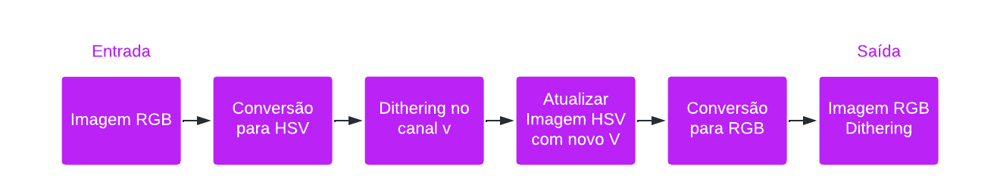

[1] F. Mohammad and A. Munir, "Image Compression via Dithering for Enhanced Images," 2007 International Conference on Electrical Engineering, 2007, pp. 1-7, doi: 10.1109/ICEE.2007.4287322.

## Bibliotecas 
Bibliotecas auxiliares para a análise dos dados

In [ ]:
import numpy as np
import imageio
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
import os

# Funções
Funções auxiliares para a análise dos dados

In [ ]:
def sub_plot_monocromatic(img1,img2,img3,img4):
  """
  Função que plota todos os canais de cores uma imagem
  inputs:
  img - imagem 
  outputs:
  plot de cada imagem de entrada em monocromatico
  """
  plt.figure(figsize=(25,25)) 
  plt.subplot(141)
  plt.imshow(img1,cmap="gray")
  plt.title('Imagem 1')
  plt.axis('off') 

  plt.subplot(142) 
  plt.imshow(img2,cmap="gray")
  plt.title('Imagem 2')
  plt.axis('off') 

  plt.subplot(143)
  plt.imshow(img3,cmap="gray")
  plt.title('Imagem 3')
  plt.axis('off') 

  plt.subplot(144)
  plt.imshow(img4,cmap="gray")
  plt.title('Imagem 4')
  plt.axis('off') 


In [ ]:
def sub_plot(img1,img2,img3,img4):
  """
  Função que plota todos os canais de cores uma imagem
  inputs:
  img - imagem 
  outputs:
  plot de cada imagem de entrada em RGB
  """
  plt.figure(figsize=(25,25)) 
  plt.subplot(141)
  plt.imshow(img1)
  plt.title('Imagem 1')
  plt.axis('off') 

  plt.subplot(142) 
  plt.imshow(img2)
  plt.title('Imagem 2')
  plt.axis('off') 

  plt.subplot(143)
  plt.imshow(img3)
  plt.title('Imagem 3')
  plt.axis('off') 

  plt.subplot(144)
  plt.imshow(img4)
  plt.title('Imagem 4')
  plt.axis('off') 

In [ ]:
def sub_plot_7(img1,img2,img3,img4,im5,im6,img7):
  """
  Função que plota todos os canais de cores uma imagem
  inputs:
  img - imagem 
  outputs:
  plot de cada imagem de entrada em RGB
  """
  plt.figure(figsize=(25,25)) 
  plt.subplot(171)
  plt.imshow(img1)
  plt.title('Imagem Original')
  plt.axis('off') 

  plt.subplot(172) 
  plt.imshow(img2)
  plt.title('F1')
  plt.axis('off') 

  plt.subplot(173)
  plt.imshow(img3)
  plt.title('F2')
  plt.axis('off') 

  plt.subplot(174)
  plt.imshow(img4)
  plt.title('F3')
  plt.axis('off') 

  plt.subplot(175)
  plt.imshow(img4)
  plt.title('F4')
  plt.axis('off') 

  plt.subplot(176)
  plt.imshow(img4)
  plt.title('F5')
  plt.axis('off') 

  plt.subplot(177)
  plt.imshow(img4)
  plt.title('F6')
  plt.axis('off') 



In [ ]:
def sub_plot_2(img1,img2):
  """
  Função que plota todos os canais de cores uma imagem

  inputs:
  img - imagem 
  
  outputs:
  plot de duas imagem, uma em escalas de cinza e RGB
  """
  plt.figure(figsize=(25,25)) 
  plt.subplot(121)
  plt.imshow(img1,cmap='gray')
  plt.title('Imagem em cinza')
  plt.axis('off') 

  plt.subplot(122) 
  plt.imshow(img2)
  plt.title('Imagem RBG')
  plt.axis('off') 

In [ ]:
def rgb_to_hsv(img):
  """
  Função que converte uma imagem em RGB para HSV

  input:
  img - imagem rgb
  
  outputs:
  img_hsv - imagem de entrada em HSV
  img_v - canal v
  """
  img_hsv = mpl.colors.rgb_to_hsv(img)
  img_v = img_hsv[:,:,2]
  return img_hsv,img_v

In [ ]:
def hsv_to_rgb(img_f_x,img_hsv):
  """
  Função que acrescenta o novo canal v e converte uma imagem em HSV para RGB 

  input:
  img_f_x - imagem resultante do filtro f com scan x (novo canal v)
  img_hsv - imagem hsv

  outputs:
  img_rgb - imagem de entrada em RGB
  """
  img_f_x_c = img_f_x.copy()
  img_hsv_f_x = img_hsv.copy()
  img_hsv_f_x[:,:,2]=img_f_x_c
  img_rgb = mpl.colors.hsv_to_rgb(img_hsv_f_x)
  return img_rgb

# Inputs
Foram escolhidas 4 imagens coloridas de entrada de exemplo para análise: Baboon (512, 512, 3), monalisa (256, 256, 3), peppers (512, 512, 3) e watch(768, 1024, 3).

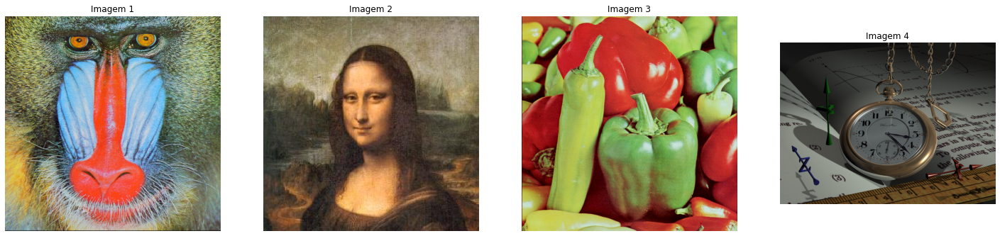

In [ ]:
img1 = imageio.imread('baboon.png')
img2 = imageio.imread('monalisa.png')
img3 = imageio.imread('peppers.png')
img4 = imageio.imread('watch.png')
sub_plot(img1,img2,img3,img4)

In [ ]:
img1.shape

(512, 512, 3)

In [ ]:
img2.shape

(256, 256, 3)

In [ ]:
img3.shape

(512, 512, 3)

In [ ]:
img4.shape

(768, 1024, 3)

# Preprocessamento

Consiste em uma etapa simples de conversão de RGB para HSV e selecionar o canal V para a implementação do dithering.

O canal RGB expressa os valores de cores em 3 canais (vermelho, verde e azul), já o HSV expressa em seus canais hue (matiz), saturation (saturação) e value (valor ou luminância). 

Para fazer o dithering em imagens coloridas, não é interessante alterar seus canais de cores pelo RGB, mas sim alterar o valor de luminância do pixel. A fim de que as características originais de cores sejam mantidas, porém haja uma redução da quantidade de cores seja usada e ainda seja mantido uma boa visualização do usuário.

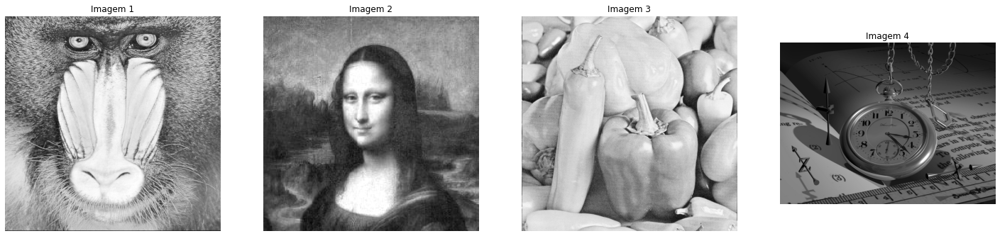

In [ ]:
img1_hsv,img1_v = rgb_to_hsv(img1) #imagem 1
img2_hsv,img2_v = rgb_to_hsv(img2) #imagem 2
img3_hsv,img3_v = rgb_to_hsv(img3) #imagem 3
img4_hsv,img4_v = rgb_to_hsv(img4) #imagem 4
sub_plot_monocromatic(img1_v,img2_v,img3_v,img4_v)

# Experimentos
Serão apresentados 6 filtros que utilizam a distribuição de erros para realização do Dithering: Floyd e Steinberg, Stevenson e Arce, Burkes, Sierra, Stucki e Jarvis, Judice e Ninke.

Todos possuem duas opções de scan da imagem, seguindo a orientação normal(esquerda para direita) e zigzag (uma linha da esquerda para direita, seguida de uma direita para esquerda e repete-se).

Todos possuem como entrada a imagem do canal v e um parametro da orientação do scan(0 para norma e 1 para zigzag) e saída a imagem de dithering g binarizada.

Os filtros utilizam distribuição de erros, onde para em cada pixel, um valor de erro é acrescentado nos seus pixel vizinhos menos o antecedente. No caso da scan zigzag - quando a varredura ocorre da direita para esquerda-, os filtros são espelhados em x para que o pixel anterior não seja alterado e a distribuição do erro esteja correta conforme a orientação do scan. 

Essas operações são feitas in-place e a imagem resultante é dada por g, que possui valores de 1 e 0, dependendo do valor do pixel visitado.

Cada saída (g) de cada funções, foram substituidas no canal V da imagem original e então foram convertidas a RGB.

Foi feita a analise em ambos os scans para todos os filtros para as 4 imagens de entrada.

Por fim, é feita uma analise de uso de memória antes e depois do dithering.

## F1: Floyd e Steinberg

O filtro possui a distribuição de erros apresentada pela imagem a seguir.

A fim de aplicar o filtro a imagem foi necessário a adição de padding a imagem. Foi escolhido fazer um padding de zeros em volta de toda a imagem de um pixel.

A imagem g foi inicializada com uma matriz de zeros com a dimensão da imagem com padding e retornada no final da função como um slice excluíndo o padding.


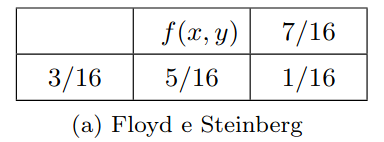

In [ ]:
def floyd_steinberg(img, scan):
  """
  Função que retorna o dithering utilizando o filtro floyd_streinberg

  inputs:
  img - canal v de uma imagem
  scan - orientação do scan da imagem (0 - nomal, 1 - zigzag)

  output:
  g - resultado do dithering
  """

  img_v = img.copy()  
  h,w  = img_v.shape  #dimensoes da imagem original 
  f = np.pad(img_v,(1,1), 'constant', constant_values=(0, 0)) #padding com uma camada de 0 nas duas dimensoes
  g = np.zeros((f.shape[0],f.shape[1])) #imagem de saida iniciada com zeros do tamanho de f
  erro = 0
    
  if scan == 0: #scan normal
    for y in range(1,h+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
      for x in range(1,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
        if f[y,x]<128:
          g[y,x]=0
        else:
          g[y,x]=1

        erro = f[y,x] - g[y,x]*255
    
        f[y,x+1]+=(7/16)*erro
        f[y+1,x+1]+=(1/16)*erro
        f[y+1,x]+=(5/16)*erro
        f[y+1,x-1]+=(3/16)*erro

  elif scan == 1: #scan zigzag
    for y in range(1,h+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
      if y%2!=0:  #quando y for impar, o filtro seguira a orientacao normal (esquerda para a direita)
        for x in range(1,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1

          erro = f[y,x] - g[y,x]*255
          
          f[y,x+1]+=(7/16)*erro
          f[y+1,x+1]+=(1/16)*erro
          f[y+1,x]+=(5/16)*erro
          f[y+1,x-1]+=(3/16)*erro

      else: #quando y for par, o filtro seguira a orientacao contraria (direita para a esquerda)
        for x in range(w,1, -1): # a iteracao começa dps do padding e vai ate o primeiro pixel da imagem original
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1

          erro = f[y,x] - g[y,x]*255

          f[y,x-1]+=(7/16)*erro
          f[y+1,x-1]+=(1/16)*erro
          f[y+1,x]+=(5/16)*erro
          f[y+1,x+1]+=(3/16)*erro

  return  g[1:-1,1:-1] #retorna g sem o padding

### Normal Scan

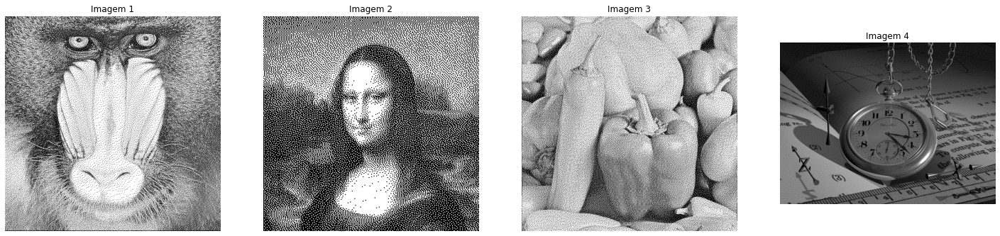

In [ ]:
img1_f1_n=floyd_steinberg(img1_v, 0)
img2_f1_n=floyd_steinberg(img2_v, 0)
img3_f1_n=floyd_steinberg(img3_v, 0)
img4_f1_n=floyd_steinberg(img4_v, 0)
sub_plot_monocromatic(img1_f1_n,img2_f1_n,img3_f1_n,img4_f1_n)

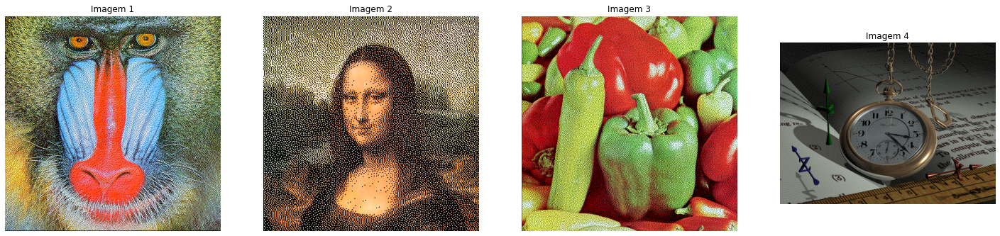

In [ ]:
img1_rgb_f1_n = hsv_to_rgb(img1_f1_n,img1_hsv)
img2_rgb_f1_n = hsv_to_rgb(img2_f1_n,img2_hsv)
img3_rgb_f1_n = hsv_to_rgb(img3_f1_n,img3_hsv)
img4_rgb_f1_n = hsv_to_rgb(img4_f1_n,img4_hsv)
sub_plot(img1_rgb_f1_n,img2_rgb_f1_n,img3_rgb_f1_n,img4_rgb_f1_n)

In [ ]:
#imageio.imwrite("results/f1/n/img1_rgb_f1_n.png", img1_rgb_f1_n)
#imageio.imwrite("results/f1/n/img2_rgb_f1_n.png", img2_rgb_f1_n)
#imageio.imwrite("results/f1/n/img3_rgb_f1_n.png", img3_rgb_f1_n)
#imageio.imwrite("results/f1/n/img4_rgb_f1_n.png", img4_rgb_f1_n)


### Zigzag Scan

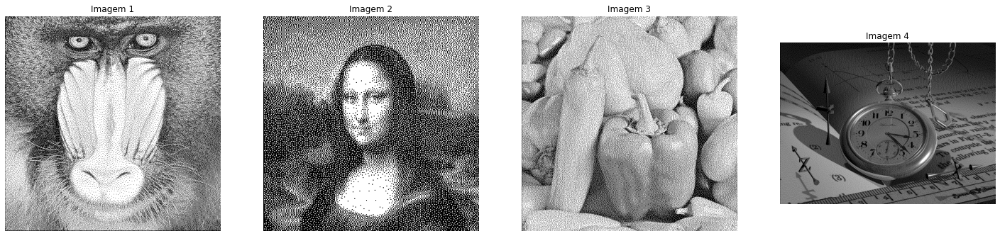

In [ ]:
img1_f1_z=floyd_steinberg(img1_v, 1)
img2_f1_z=floyd_steinberg(img2_v, 1)
img3_f1_z=floyd_steinberg(img3_v, 1)
img4_f1_z=floyd_steinberg(img4_v, 1)
sub_plot_monocromatic(img1_f1_z,img2_f1_z,img3_f1_z,img4_f1_z)

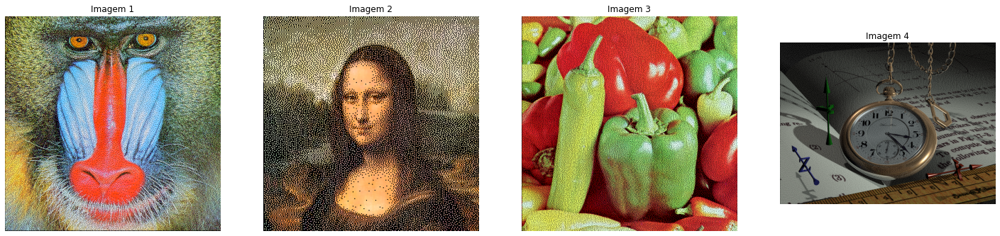

In [ ]:
img1_rgb_f1_z = hsv_to_rgb(img1_f1_z,img1_hsv)
img2_rgb_f1_z = hsv_to_rgb(img2_f1_z,img2_hsv)
img3_rgb_f1_z = hsv_to_rgb(img3_f1_z,img3_hsv)
img4_rgb_f1_z = hsv_to_rgb(img4_f1_z,img4_hsv)
sub_plot(img1_rgb_f1_z,img2_rgb_f1_z,img3_rgb_f1_z,img4_rgb_f1_z)

In [ ]:
#imageio.imwrite("results/f1/z/img1_rgb_f1_z.png", img1_rgb_f1_z)
#imageio.imwrite("results/f1/z/img2_rgb_f1_z.png", img2_rgb_f1_z)
#imageio.imwrite("results/f1/z/img3_rgb_f1_z.png", img3_rgb_f1_z)
#imageio.imwrite("results/f1/z/img4_rgb_f1_z.png", img4_rgb_f1_z)

### Discussões

Observa-se que para imagens maiores como a imagem 4 e imagens com muita textura como a 1, é bem sutil o dithering com o filtro 1 em ambas as direções.

Porém, para a imagem 2 é possível observar um padrão e uma perda de informações, porém, o filtro ainda mantem detalhes e características da imagem.

A imagem 3 parece levemente ruidosa, porém o filtro manteve os detalhes da imagem.

Foi observado que no normal scan há um padrão de direção na imagem.

## F2: Stevenson e Arce

O filtro possui a distribuição de erros apresentada pela imagem a seguir.

A fim de aplicar o filtro a imagem foi necessário a adição de padding a imagem. Foi escolhido fazer um padding de zeros em volta de toda a imagem de 3 pixel.

A imagem g foi inicializada com uma matriz de zeros com a dimensão da imagem com padding e retornada no final da função como um slice excluíndo o padding.

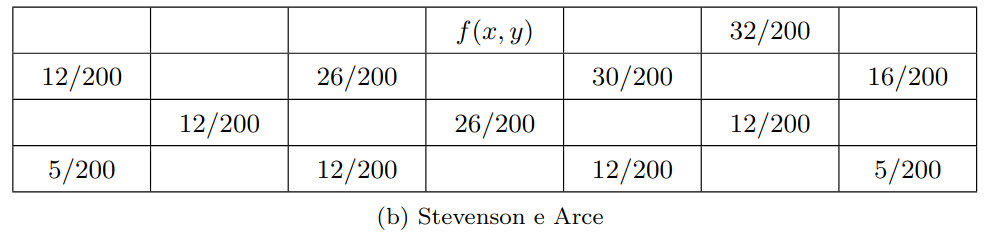

In [ ]:
def stevenson_arce(img, scan):
  """
  Função que retorna o dithering utilizando o filtro stevenson_arce

  inputs:
  img - canal v de uma imagem
  scan - orientação do scan da imagem (0 - nomal, 1 - zigzag)

  output:
  g - resultado do dithering
  """

  img_v =np.copy(img)
  h, w = img_v.shape #dimensoes da imagem original 
  f = np.pad(img_v,(3, 3), 'constant', constant_values=(0, 0)) #padding com uma camada de 0 nas duas dimensoes
  g = np.zeros((f.shape[0],f.shape[1])) #imagem de saida iniciada com zeros do tamanho de f
  erro = 0

  if scan == 0: #scan normal
    for y in range(3,h+1):  # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
      for x in range(3,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
        if f[y,x]<128:
          g[y,x]=0
        else:
          g[y,x]=1
        erro = f[y,x] - g[y,x]*255

        f[y,x+2]+=(32/200)*erro

        f[y+1,x-3]+=(12/200)*erro
        f[y+1,x-1]+=(26/200)*erro
        f[y+1,x+1]+=(30/200)*erro
        f[y+1,x+3]+=(16/200)*erro

        f[y+2,x-2]+=(12/200)*erro
        f[y+2,x]+=(26/200)*erro
        f[y+2,x+2]+=(12/200)*erro

        f[y+3,x-3]+=(5/200)*erro
        f[y+3,x-1]+=(12/200)*erro
        f[y+3,x+1]+=(12/200)*erro
        f[y+3,x+3]+=(5/200)*erro
        
  elif scan == 1: #scan zigzag
    for y in range(3,h+1):
      if y%2!=0:  #quando y for impar, o filtro seguira a orientacao normal (esquerda para a direita)
        for x in range(3, w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1
          erro = f[y,x] - g[y,x]*255
          f[y,x+2]+=(32/200)*erro

          f[y+1,x-3]+=(12/200)*erro
          f[y+1,x-1]+=(26/200)*erro
          f[y+1,x+1]+=(30/200)*erro
          f[y+1,x+3]+=(16/200)*erro

          f[y+2,x-2]+=(12/200)*erro
          f[y+2,x]+=(26/200)*erro
          f[y+2,x+2]+=(12/200)*erro

          f[y+3,x-3]+=(5/200)*erro
          f[y+3,x-1]+=(12/200)*erro
          f[y+3,x+1]+=(12/200)*erro
          f[y+3,x+3]+=(5/200)*erro
      else: #quando y for par, o filtro seguira a orientacao contraria (direita para a esquerda)
        for x in range(w,3, -1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1
          erro = f[y,x] - g[y,x]*255
          f[y,x-2]+=(32/200)*erro

          f[y+1,x+3]+=(12/200)*erro
          f[y+1,x+1]+=(26/200)*erro
          f[y+1,x-1]+=(30/200)*erro
          f[y+1,x-3]+=(16/200)*erro

          f[y+2,x+2]+=(12/200)*erro
          f[y+2,x]+=(26/200)*erro
          f[y+2,x-2]+=(12/200)*erro

          f[y+3,x+3]+=(5/200)*erro
          f[y+3,x+1]+=(12/200)*erro
          f[y+3,x-1]+=(12/200)*erro
          f[y+3,x-3]+=(5/200)*erro

  return g[3:-3,3:-3] #retorna g sem o padding

### Normal Scan

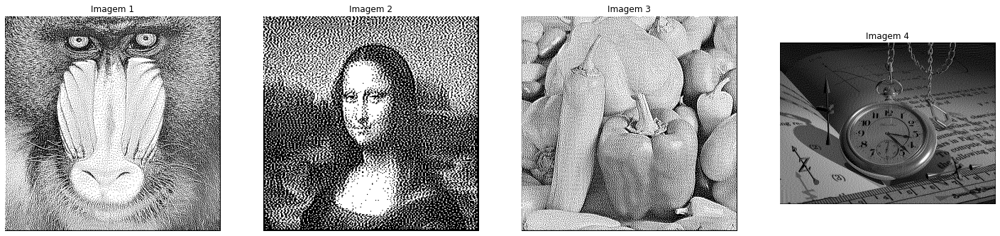

In [ ]:
img1_f2_n=stevenson_arce(img1_v, 0)
img2_f2_n=stevenson_arce(img2_v, 0)
img3_f2_n=stevenson_arce(img3_v, 0)
img4_f2_n=stevenson_arce(img4_v, 0)
sub_plot_monocromatic(img1_f2_n,img2_f2_n,img3_f2_n,img4_f2_n)

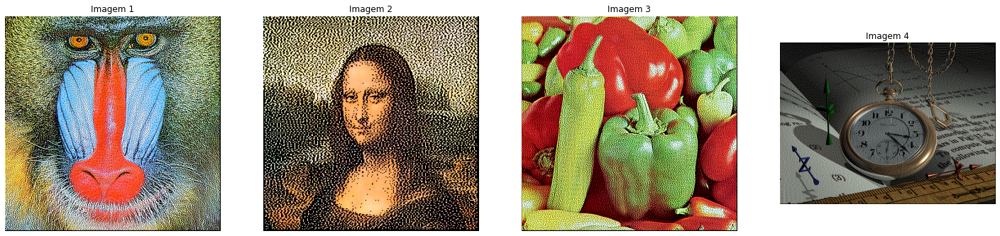

In [ ]:
img1_rgb_f2_n = hsv_to_rgb(img1_f2_n,img1_hsv)
img2_rgb_f2_n = hsv_to_rgb(img2_f2_n,img2_hsv)
img3_rgb_f2_n = hsv_to_rgb(img3_f2_n,img3_hsv)
img4_rgb_f2_n = hsv_to_rgb(img4_f2_n,img4_hsv)
sub_plot(img1_rgb_f2_n,img2_rgb_f2_n,img3_rgb_f2_n,img4_rgb_f2_n)

In [ ]:
# imageio.imwrite("results/f2/n/img1_rgb_f2_n.png", img1_rgb_f2_n)
# imageio.imwrite("results/f2/n/img2_rgb_f2_n.png", img2_rgb_f2_n)
# imageio.imwrite("results/f2/n/img3_rgb_f2_n.png", img3_rgb_f2_n)
# imageio.imwrite("results/f2/n/img4_rgb_f2_n.png", img4_rgb_f2_n)

### Zigzag Scan

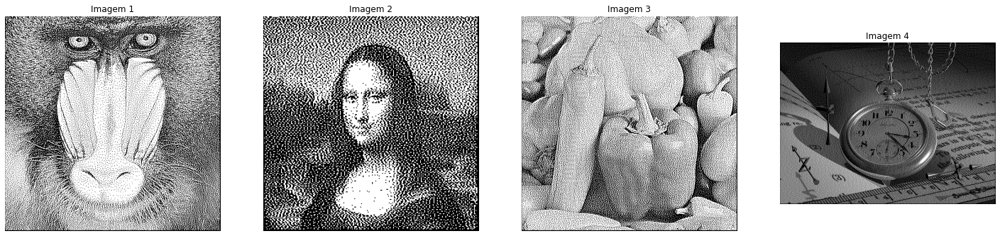

In [ ]:
img1_f2_z=stevenson_arce(img1_v, 1)
img2_f2_z=stevenson_arce(img2_v, 1)
img3_f2_z=stevenson_arce(img3_v, 1)
img4_f2_z=stevenson_arce(img4_v, 1)
sub_plot_monocromatic(img1_f2_z,img2_f2_z,img3_f2_z,img4_f2_z)

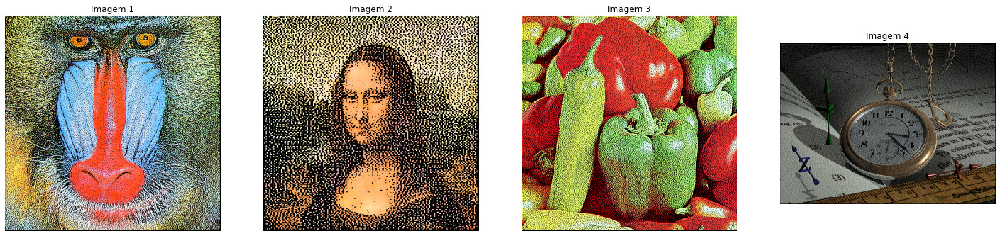

In [ ]:
img1_rgb_f2_z = hsv_to_rgb(img1_f2_z,img1_hsv)
img2_rgb_f2_z = hsv_to_rgb(img2_f2_z,img2_hsv)
img3_rgb_f2_z = hsv_to_rgb(img3_f2_z,img3_hsv)
img4_rgb_f2_z = hsv_to_rgb(img4_f2_z,img4_hsv)
sub_plot(img1_rgb_f2_z,img2_rgb_f2_z,img3_rgb_f2_z,img4_rgb_f2_z)

In [ ]:
# imageio.imwrite("results/f2/z/img1_rgb_f2_z.png", img1_rgb_f2_z)
# imageio.imwrite("results/f2/z/img2_rgb_f2_z.png", img2_rgb_f2_z)
# imageio.imwrite("results/f2/z/img3_rgb_f2_z.png", img3_rgb_f2_z)
# imageio.imwrite("results/f2/z/img4_rgb_f2_z.png", img4_rgb_f2_z)

### Discussões
Em ambas as direções, observa-se que na imagem 1, observa-se que o contraste foi aumentado e alguns detalhes da texturas no pelo foi perdida por isso.

Na imagem 2, há uma grande distorção, onde grandes detalhes foram perdidos e também em regiões homogêneas há um grande destaque sem o pontilhamento do ditering.

Na imagem 3, é visível padrões de varredura em ambas orientações.
 
Por fim, na imagem 4, é possível ver uma distorção dos detalhes e de regões homogêneas.

Não observou-se uma diferença clara entre as diferentes varreduras.

## F3: Burkes
O filtro possui a distribuição de erros apresentada pela imagem a seguir.

A fim de aplicar o filtro a imagem foi necessário a adição de padding a imagem. Foi escolhido fazer um padding de zeros em volta de toda a imagem de 2 pixel.

A imagem g foi inicializada com uma matriz de zeros com a dimensão da imagem com padding e retornada no final da função como um slice excluíndo o padding.

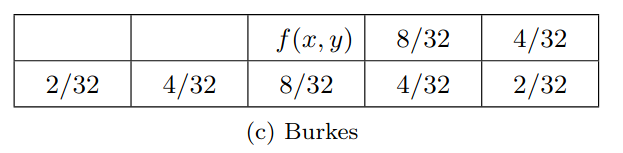

In [ ]:
def burkes(img,scan):
  """
  Função que retorna o dithering utilizando o filtro burkes

  inputs:
  img - canal v de uma imagem
  scan - orientação do scan da imagem (0 - nomal, 1 - zigzag)

  output:
  g - resultado do dithering
  """

  img_v =np.copy(img)
  h, w = img_v.shape #dimensoes da imagem original
  f = np.pad(img_v,(2, 2), 'constant', constant_values=(0, 0)) #padding com uma camada de 0 nas duas dimensoes
  g = np.zeros((f.shape[0],f.shape[1])) #imagem de saida iniciada com zeros do tamanho de f
  erro = 0

  if scan == 0: #scan normal
    for y in range(2,h+1):  # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
      for x in range(2,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
        if f[y,x]<128:
          g[y,x]=0
        else:
          g[y,x]=1
          
        erro = f[y,x] - g[y,x]*255

        f[y,x+1]+=(8/32)*erro
        f[y,x+2]+=(4/32)*erro

        f[y+1,x-2]+=(2/32)*erro
        f[y+1,x-1]+=(4/32)*erro
        f[y+1,x]+=(8/32)*erro
        f[y+1,x+1]+=(4/32)*erro
        f[y+1,x+2]+=(2/32)*erro

  elif scan == 1: #scan zigzag
    for y in range(2,h+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
      if y%2==0:   #quando y for par, o filtro seguira a orientacao normal (esquerda para a direita)
        for x in range(2,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1

          erro = f[y,x] - g[y,x]*255

          f[y,x+1]+=(8/32)*erro
          f[y,x+2]+=(4/32)*erro

          f[y+1,x-2]+=(2/32)*erro
          f[y+1,x-1]+=(4/32)*erro
          f[y+1,x]+=(8/32)*erro
          f[y+1,x+1]+=(4/32)*erro
          f[y+1,x+2]+=(2/32)*erro
      else: #quando y for impar, o filtro seguira a orientacao contraria (direita para a esquerda)
        for x in range(w,2, -1): # a iteracao começa dps do padding e vai ate o primeiro pixel da imagem original
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1
          erro = f[y,x] - g[y,x]*255
          
          f[y,x-1]+=(8/32)*erro
          f[y,x-2]+=(4/32)*erro

          f[y+1,x+2]+=(2/32)*erro
          f[y+1,x+1]+=(4/32)*erro
          f[y+1,x]+=(8/32)*erro
          f[y+1,x-1]+=(4/32)*erro
          f[y+1,x-2]+=(2/32)*erro

  return g[2:-2,2:-2] #retorna g sem o padding

### Normal Scan

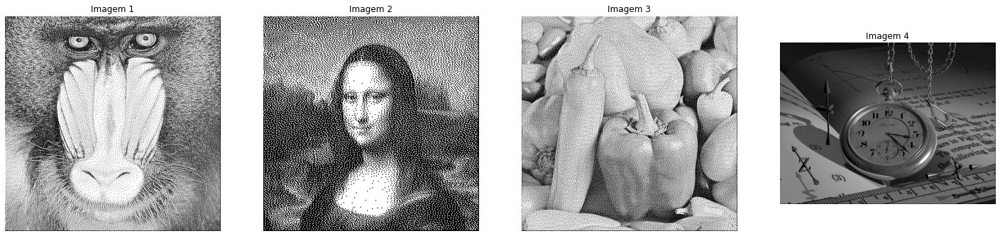

In [ ]:
img1_f3_n=burkes(img1_v, 0)
img2_f3_n=burkes(img2_v, 0)
img3_f3_n=burkes(img3_v, 0)
img4_f3_n=burkes(img4_v, 0)
sub_plot_monocromatic(img1_f3_n,img2_f3_n,img3_f3_n,img4_f3_n)

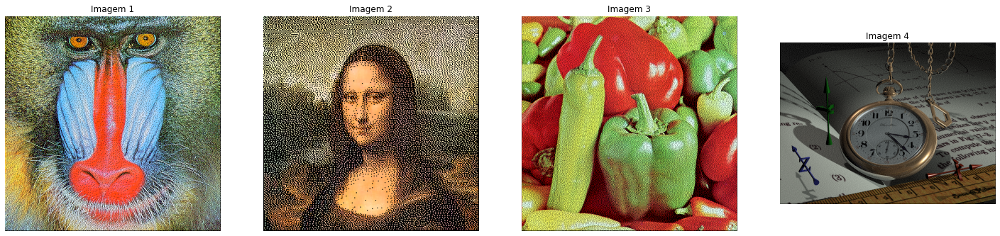

In [ ]:
img1_rgb_f3_n = hsv_to_rgb(img1_f3_n,img1_hsv)
img2_rgb_f3_n = hsv_to_rgb(img2_f3_n,img2_hsv)
img3_rgb_f3_n = hsv_to_rgb(img3_f3_n,img3_hsv)
img4_rgb_f3_n = hsv_to_rgb(img4_f3_n,img4_hsv)
sub_plot(img1_rgb_f3_n,img2_rgb_f3_n,img3_rgb_f3_n,img4_rgb_f3_n)

In [ ]:
# imageio.imwrite("results/f3/n/img1_rgb_f3_n.png", img1_rgb_f3_n)
# imageio.imwrite("results/f3/n/img2_rgb_f3_n.png", img2_rgb_f3_n)
# imageio.imwrite("results/f3/n/img3_rgb_f3_n.png", img3_rgb_f3_n)
# imageio.imwrite("results/f3/n/img4_rgb_f3_n.png", img4_rgb_f3_n)

### Zigzag Scan

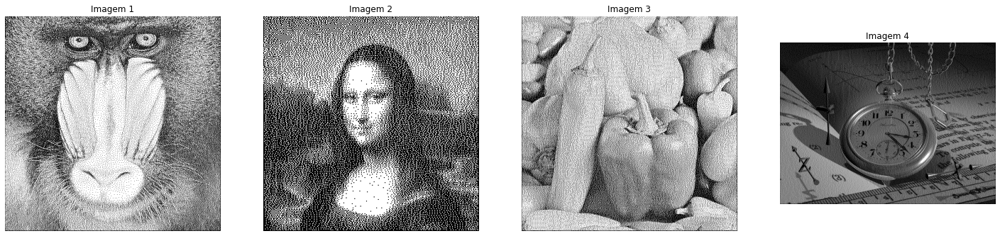

In [ ]:
img1_f3_z=burkes(img1_v, 1)
img2_f3_z=burkes(img2_v, 1)
img3_f3_z=burkes(img3_v, 1)
img4_f3_z=burkes(img4_v, 1)
sub_plot_monocromatic(img1_f3_z,img2_f3_z,img3_f3_z,img4_f3_z)

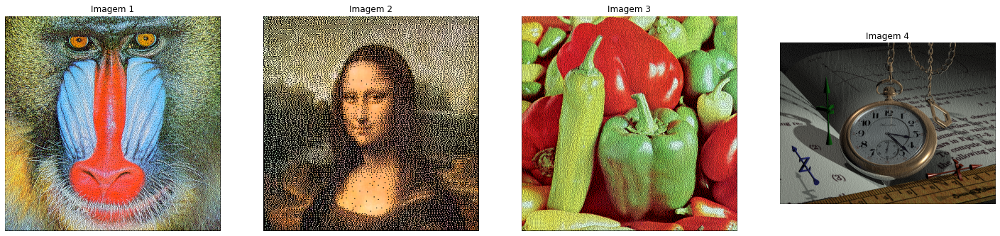

In [ ]:
img1_rgb_f3_z = hsv_to_rgb(img1_f3_z,img1_hsv)
img2_rgb_f3_z = hsv_to_rgb(img2_f3_z,img2_hsv)
img3_rgb_f3_z = hsv_to_rgb(img3_f3_z,img3_hsv)
img4_rgb_f3_z = hsv_to_rgb(img4_f3_z,img4_hsv)
sub_plot(img1_rgb_f3_z,img2_rgb_f3_z,img3_rgb_f3_z,img4_rgb_f3_z)

In [ ]:
# imageio.imwrite("results/f3/z/img1_rgb_f3_z.png", img1_rgb_f3_z)
# imageio.imwrite("results/f3/z/img2_rgb_f3_z.png", img2_rgb_f3_z)
# imageio.imwrite("results/f3/z/img3_rgb_f3_z.png", img3_rgb_f3_z)
# imageio.imwrite("results/f3/z/img4_rgb_f3_z.png", img4_rgb_f3_z)

### Discussões

O resultado da imagem 1 é bem satisfatório, pois como é uma imagem com muita textura, o dithering com o filtro 3 ficou bem suave. 

Na imagem 2, como nas anteriores, é possíbel observar o padrão de varredura (nas duas orientações), porém diferente do filtro 2, o filtro 3 é mais suave e perde menos detalhes originais da imagem.

Nas imagens 3 e 4 é possível obserar um padrão vertical na orientação zizag.

## F4: Sierra

O filtro possui a distribuição de erros apresentada pela imagem a seguir.

A fim de aplicar o filtro a imagem foi necessário a adição de padding a imagem. Foi escolhido fazer um padding de zeros em volta de toda a imagem de 2 pixel.

A imagem g foi inicializada com uma matriz de zeros com a dimensão da imagem com padding e retornada no final da função como um slice excluíndo o padding.

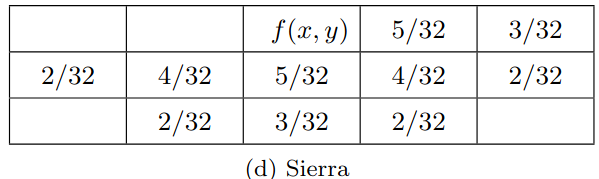

In [ ]:
def sierra(img,scan ='normal'):
  """
  Função que retorna o dithering utilizando o filtro sierra

  inputs:
  img - canal v de uma imagem
  scan - orientação do scan da imagem (0 - nomal, 1 - zigzag)

  output:
  g - resultado do dithering
  """

  img_v =np.copy(img) 
  h, w = img_v.shape #dimensoes da imagem original
  f = np.pad(img_v,(2, 2), 'constant', constant_values=(0, 0)) #padding com uma camada de 0 nas duas dimensoes
  g = np.zeros((f.shape[0],f.shape[1])) #imagem de saida iniciada com zeros do tamanho de f
  erro = 0

  if scan == 0: #scan normal
    for y in range(2,h+1):  # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
      for x in range(2,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
        if f[y,x]<128:
          g[y,x]=0
        else:
          g[y,x]=1
        erro = f[y,x] - g[y,x]*255

        f[y,x+1]+=(5/32)*erro
        f[y,x+2]+=(3/32)*erro
        
        f[y+1,x-2]+=(2/32)*erro
        f[y+1,x-1]+=(4/32)*erro
        f[y+1,x]+=(5/32)*erro
        f[y+1,x+1]+=(4/32)*erro
        f[y+1,x+2]+=(2/32)*erro

        f[y+2,x-1]+=(2/32)*erro
        f[y+2,x]+=(3/32)*erro
        f[y+2,x+1]+=(2/32)*erro

  elif scan == 1: #scan zigzag 
    for y in range(2,h+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
      if y%2==0:    #quando y for par, o filtro seguira a orientacao normal (esquerda para a direita)
        for x in range(2,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1
          erro = f[y,x] - g[y,x]*255

          f[y,x+1]+=(5/32)*erro
          f[y,x+2]+=(3/32)*erro
          
          f[y+1,x-2]+=(2/32)*erro
          f[y+1,x-1]+=(4/32)*erro
          f[y+1,x]+=(5/32)*erro
          f[y+1,x+1]+=(4/32)*erro
          f[y+1,x+2]+=(2/32)*erro

          f[y+2,x-1]+=(2/32)*erro
          f[y+2,x]+=(3/32)*erro
          f[y+2,x+1]+=(2/32)*erro
      else: #quando y for impar, o filtro seguira a orientacao contraria (direita para a esquerda)
        for x in range(w,2,-1): # a iteracao começa dps do padding e vai ate o primeiro pixel da imagem original
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1
          erro = f[y,x] - g[y,x]*255
          f[y,x-1]+=(5/32)*erro
          f[y,x-2]+=(3/32)*erro
          
          f[y+1,x+2]+=(2/32)*erro
          f[y+1,x+1]+=(4/32)*erro
          f[y+1,x]+=(5/32)*erro
          f[y+1,x-1]+=(4/32)*erro
          f[y+1,x-2]+=(2/32)*erro

          f[y+2,x+1]+=(2/32)*erro
          f[y+2,x]+=(3/32)*erro
          f[y+2,x-1]+=(2/32)*erro

  return g[2:-2,2:-2]  #retorna g sem o padding

### Normal Scan

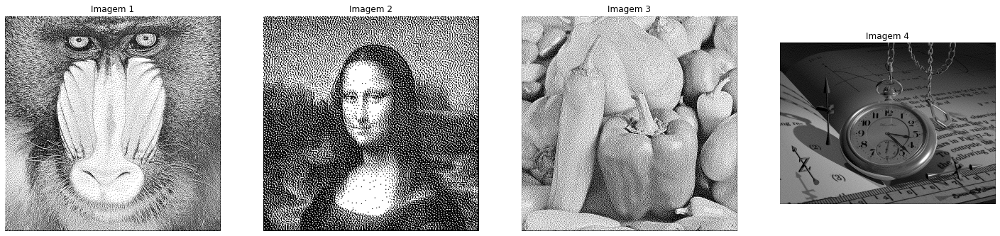

In [ ]:
img1_f4_n=sierra(img1_v, 0)
img2_f4_n=sierra(img2_v, 0)
img3_f4_n=sierra(img3_v, 0)
img4_f4_n=sierra(img4_v, 0)
sub_plot_monocromatic(img1_f4_n,img2_f4_n,img3_f4_n,img4_f4_n)

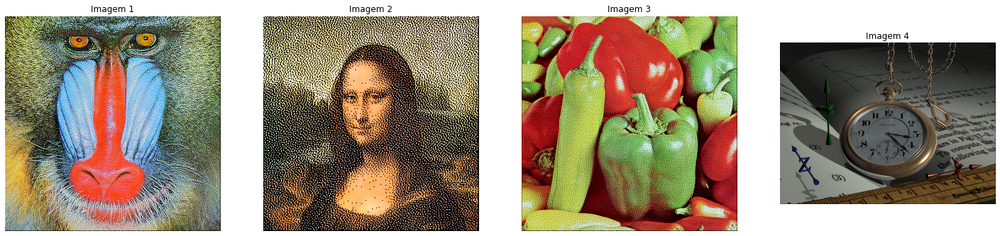

In [ ]:
img1_rgb_f4_n = hsv_to_rgb(img1_f4_n,img1_hsv)
img2_rgb_f4_n = hsv_to_rgb(img2_f4_n,img2_hsv)
img3_rgb_f4_n = hsv_to_rgb(img3_f4_n,img3_hsv)
img4_rgb_f4_n = hsv_to_rgb(img4_f4_n,img4_hsv)
sub_plot(img1_rgb_f4_n,img2_rgb_f4_n,img3_rgb_f4_n,img4_rgb_f4_n)

In [ ]:
# imageio.imwrite("results/f4/n/img1_rgb_f4_n.png", img1_rgb_f4_n)
# imageio.imwrite("results/f4/n/img2_rgb_f4_n.png", img2_rgb_f4_n)
# imageio.imwrite("results/f4/n/img3_rgb_f4_n.png", img3_rgb_f4_n)
# imageio.imwrite("results/f4/n/img4_rgb_f4_n.png", img4_rgb_f4_n)

### Zigzag Scan

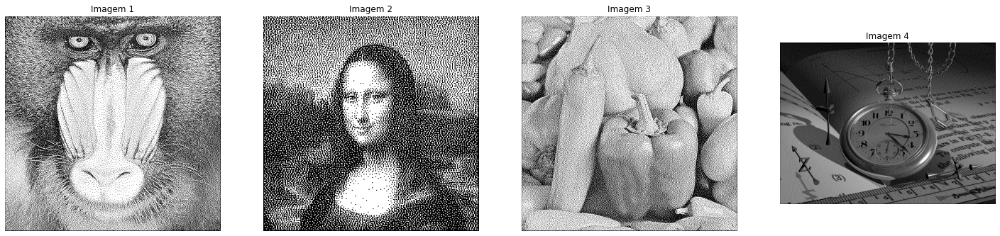

In [ ]:
img1_f4_z=sierra(img1_v, 1)
img2_f4_z=sierra(img2_v, 1)
img3_f4_z=sierra(img3_v, 1)
img4_f4_z=sierra(img4_v, 1)
sub_plot_monocromatic(img1_f4_z,img2_f4_z,img3_f4_z,img4_f4_z)

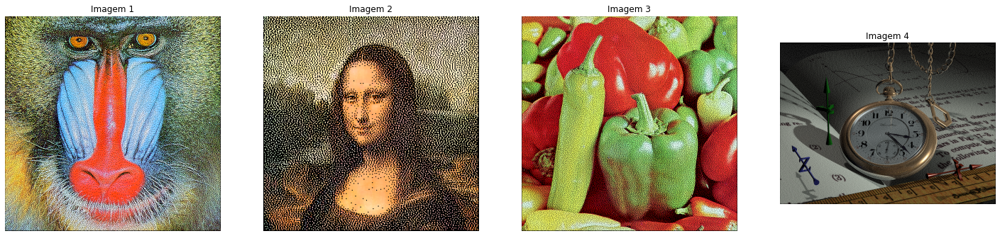

In [ ]:
img1_rgb_f4_z = hsv_to_rgb(img1_f4_z,img1_hsv)
img2_rgb_f4_z = hsv_to_rgb(img2_f4_z,img2_hsv)
img3_rgb_f4_z = hsv_to_rgb(img3_f4_z,img3_hsv)
img4_rgb_f4_z = hsv_to_rgb(img4_f4_z,img4_hsv)
sub_plot(img1_rgb_f4_z,img2_rgb_f4_z,img3_rgb_f4_z,img4_rgb_f4_z)

In [ ]:
# imageio.imwrite("results/f4/z/img1_rgb_f4_z.png", img1_rgb_f4_z)
# imageio.imwrite("results/f4/z/img2_rgb_f4_z.png", img2_rgb_f4_z)
# imageio.imwrite("results/f4/z/img3_rgb_f4_z.png", img3_rgb_f4_z)
# imageio.imwrite("results/f4/z/img4_rgb_f4_z.png", img4_rgb_f4_z)

### Discussões

Novamente o resultado na imagem 1 é muito satisfatório e também, no filtro 4. 

Na imagem 2 novamente observa-se grandes distorções, porém mais suavez que no filtro 2.

Na imagem 3, observa-se uma melhoria quanto aos filtros 2 e 3, pois não é visível o padrão de varredura. Porém, a imagem ainda aparenta estar levemente ruidosa.

Na imagem 4, em ambas orientações, apresenta uma imagem com poucas distorções, como a direção da varredura, em ambas varreduras. Porém como a zigzag alterna o padrão, essa distorção é um pouco menor.

## F5: Stucki

O filtro possui a distribuição de erros apresentada pela imagem a seguir.

A fim de aplicar o filtro a imagem foi necessário a adição de padding a imagem. Foi escolhido fazer um padding de zeros em volta de toda a imagem de 2 pixel.

A imagem g foi inicializada com uma matriz de zeros com a dimensão da imagem com padding e retornada no final da função como um slice excluíndo o padding.

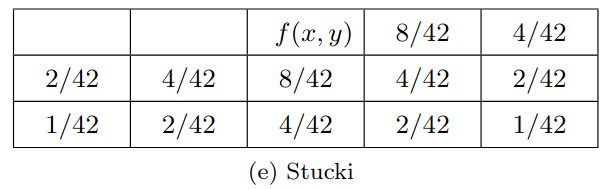

In [ ]:
def stucki(img,scan):
  """
  Função que retorna o dithering utilizando o filtro stucki

  inputs:
  img - canal v de uma imagem
  scan - orientação do scan da imagem (0 - nomal, 1 - zigzag)

  output:
  g - resultado do dithering
  """

  img_v =np.copy(img)
  h, w = img_v.shape #dimensoes da imagem original
  f = np.pad(img_v,(2, 2), 'constant', constant_values=(0, 0)) #padding com uma camada de 0 nas duas dimensoes
  g = np.zeros((f.shape[0],f.shape[1])) #imagem de saida iniciada com zeros do tamanho de f
  erro = 0

  if scan == 0: #scan normal
    for y in range(2,h+1):  # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
      for x in range(2,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
        if f[y,x]<128:
          g[y,x]=0
        else:
          g[y,x]=1
        erro = f[y,x] - g[y,x]*255

        f[y,x+1]+=(8/42)*erro
        f[y,x+2]+=(4/42)*erro
        
        f[y+1,x-2]+=(2/42)*erro
        f[y+1,x-1]+=(4/42)*erro
        f[y+1,x]+=(8/42)*erro
        f[y+1,x+1]+=(4/42)*erro
        f[y+1,x+2]+=(2/42)*erro

        f[y+2,x-2]+=(1/42)*erro
        f[y+2,x-1]+=(2/42)*erro
        f[y+2,x]+=(4/42)*erro
        f[y+2,x+1]+=(2/42)*erro
        f[y+2,x+2]+=(1/42)*erro

  elif scan == 1: #scan zigzag
    for y in range(2,h+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
      if y%2==0:   #quando y for par, o filtro seguira a orientacao normal (esquerda para a direita)
        for x in range(2,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1
          erro = f[y,x] - g[y,x]*255
          f[y,x+1]+=(8/42)*erro
          f[y,x+2]+=(4/42)*erro
          
          f[y+1,x-2]+=(2/42)*erro
          f[y+1,x-1]+=(4/42)*erro
          f[y+1,x]+=(8/42)*erro
          f[y+1,x+1]+=(4/42)*erro
          f[y+1,x+2]+=(2/42)*erro

          f[y+2,x-2]+=(1/42)*erro
          f[y+2,x-1]+=(2/42)*erro
          f[y+2,x]+=(4/42)*erro
          f[y+2,x+1]+=(2/42)*erro
          f[y+2,x+2]+=(1/42)*erro
      else: #quando y for impar, o filtro seguira a orientacao contraria (direita para a esquerda)
        for x in range(w,2, -1): # a iteracao começa dps do padding e vai ate o primeiro pixel da imagem original
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1
          erro = f[y,x] - g[y,x]*255

          f[y,x-1]+=(8/42)*erro
          f[y,x-2]+=(4/42)*erro
          
          f[y+1,x+2]+=(2/42)*erro
          f[y+1,x+1]+=(4/42)*erro
          f[y+1,x]+=(8/42)*erro
          f[y+1,x-1]+=(4/42)*erro
          f[y+1,x-2]+=(2/42)*erro

          f[y+2,x+2]+=(1/42)*erro
          f[y+2,x+1]+=(2/42)*erro
          f[y+2,x]+=(4/42)*erro
          f[y+2,x-1]+=(2/42)*erro
          f[y+2,x-2]+=(1/42)*erro

  return g[2:-2,2:-2] #retorna g sem o padding

### Normal Scan

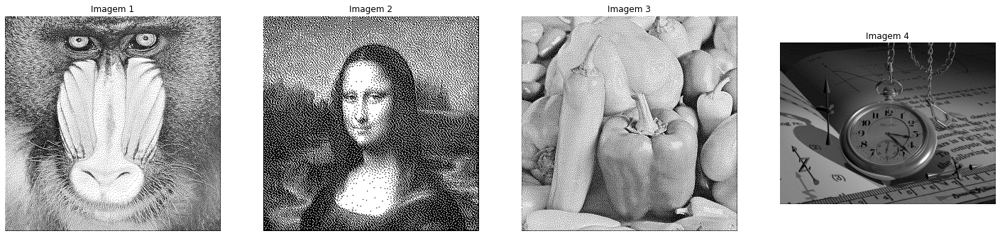

In [ ]:
img1_f5_n=stucki(img1_v, 0)
img2_f5_n=stucki(img2_v, 0)
img3_f5_n=stucki(img3_v, 0)
img4_f5_n=stucki(img4_v, 0)
sub_plot_monocromatic(img1_f5_n,img2_f5_n,img3_f5_n,img4_f5_n)

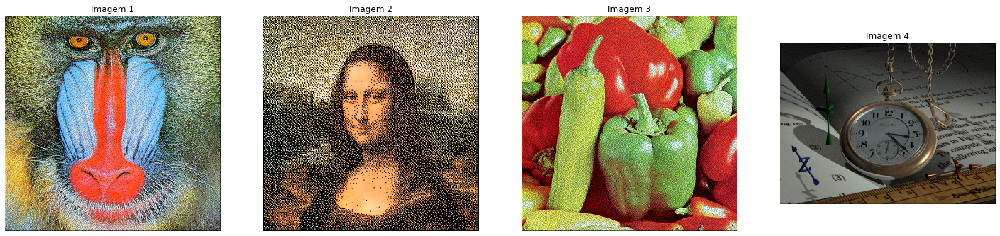

In [ ]:
img1_rgb_f5_n = hsv_to_rgb(img1_f5_n,img1_hsv)
img2_rgb_f5_n = hsv_to_rgb(img2_f5_n,img2_hsv)
img3_rgb_f5_n = hsv_to_rgb(img3_f5_n,img3_hsv)
img4_rgb_f5_n = hsv_to_rgb(img4_f5_n,img4_hsv)
sub_plot(img1_rgb_f5_n,img2_rgb_f5_n,img3_rgb_f5_n,img4_rgb_f5_n)

In [ ]:
# imageio.imwrite("results/f5/n/img1_rgb_f5_n.png", img1_rgb_f5_n)
# imageio.imwrite("results/f5/n/img2_rgb_f5_n.png", img2_rgb_f5_n)
# imageio.imwrite("results/f5/n/img3_rgb_f5_n.png", img3_rgb_f5_n)
# imageio.imwrite("results/f5/n/img4_rgb_f5_n.png", img4_rgb_f5_n)

### Zigzag Scan

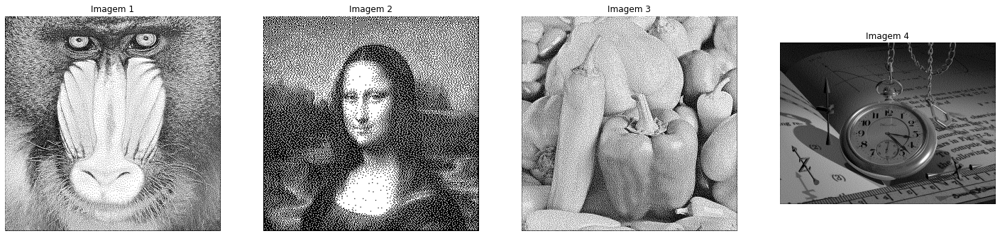

In [ ]:
img1_f5_z=stucki(img1_v, 1)
img2_f5_z=stucki(img2_v, 1)
img3_f5_z=stucki(img3_v, 1)
img4_f5_z=stucki(img4_v, 1)
sub_plot_monocromatic(img1_f5_z,img2_f5_z,img3_f4_z,img4_f5_z)

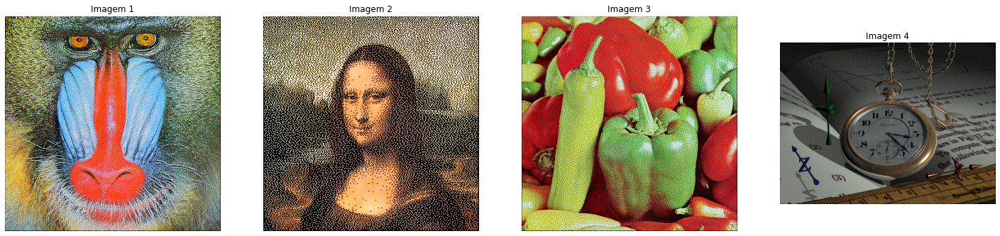

In [ ]:
img1_rgb_f5_z = hsv_to_rgb(img1_f5_z,img1_hsv)
img2_rgb_f5_z = hsv_to_rgb(img2_f5_z,img2_hsv)
img3_rgb_f5_z = hsv_to_rgb(img3_f5_z,img3_hsv)
img4_rgb_f5_z = hsv_to_rgb(img4_f5_z,img4_hsv)
sub_plot(img1_rgb_f5_z,img2_rgb_f5_z,img3_rgb_f5_z,img4_rgb_f5_z)

In [ ]:
# imageio.imwrite("results/f5/z/img1_rgb_f5_z.png", img1_rgb_f5_z)
# imageio.imwrite("results/f5/z/img2_rgb_f5_z.png", img2_rgb_f5_z)
# imageio.imwrite("results/f5/z/img3_rgb_f5_z.png", img3_rgb_f5_z)
# imageio.imwrite("results/f5/z/img4_rgb_f5_z.png", img4_rgb_f5_z)

### Discussões
É possível observar uma perda de contraste nas imagens quando comparadas as imagens originais.

Além disso, em ambas as varreduras, não há um padrão claro de direção, o que se diferencia dos outros filtros.

## F6: Jarvis, Judice e Ninke

O filtro possui a distribuição de erros apresentada pela imagem a seguir.

A fim de aplicar o filtro a imagem foi necessário a adição de padding a imagem. Foi escolhido fazer um padding de zeros em volta de toda a imagem de 2 pixel.

A imagem g foi inicializada com uma matriz de zeros com a dimensão da imagem com padding e retornada no final da função como um slice excluíndo o padding.

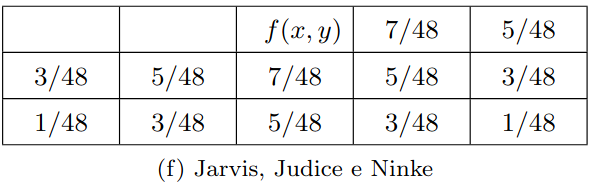

In [ ]:
def jarvis_judice_ninke(img,scan):
  """
  Função que retorna o dithering utilizando o filtro jarvis_judice_ninke

  inputs:
  img - canal v de uma imagem
  scan - orientação do scan da imagem (0 - nomal, 1 - zigzag)

  output:
  g - resultado do dithering
  """

  img_v =np.copy(img) 
  h, w = img_v.shape #dimensoes da imagem original 
  f = np.pad(img_v,(2, 2), 'constant', constant_values=(0, 0)) #padding com uma camada de 0 nas duas dimensoes
  g = np.zeros((f.shape[0],f.shape[1])) #imagem de saida iniciada com zeros do tamanho de f
  erro = 0

  if scan == 0: #scan normal
    for y in range(2,h+1):  # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original 
      for x in range(2,w+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
        if f[y,x]<128:
          g[y,x]=0
        else:
          g[y,x]=1
        erro = f[y,x] - g[y,x]*255

        f[y,x+1]+=(7/48)*erro
        f[y,x+2]+=(5/48)*erro
        
        f[y+1,x-2]+=(3/48)*erro
        f[y+1,x-1]+=(5/48)*erro
        f[y+1,x]+=(7/48)*erro
        f[y+1,x+1]+=(5/48)*erro
        f[y+1,x+2]+=(3/48)*erro

        f[y+2,x-2]+=(1/48)*erro
        f[y+2,x-1]+=(3/48)*erro
        f[y+2,x]+=(5/48)*erro
        f[y+2,x+1]+=(3/48)*erro
        f[y+2,x+2]+=(1/48)*erro

  elif scan == 1:  #scan zigzag
    for y in range(2,h+1): # a iteracao começa dps do padding e vai ate o ultimo pixel da imagem original
      if y%2==0:   #quando y for par, o filtro seguira a orientacao normal (esquerda para a direita)
        for x in range(2,w+1):
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1

          erro = f[y,x] - g[y,x]*255

          f[y,x+1]+=(7/48)*erro
          f[y,x+2]+=(5/48)*erro
          
          f[y+1,x-2]+=(3/48)*erro
          f[y+1,x-1]+=(5/48)*erro
          f[y+1,x]+=(7/48)*erro
          f[y+1,x+1]+=(5/48)*erro
          f[y+1,x+2]+=(3/48)*erro

          f[y+2,x-2]+=(1/48)*erro
          f[y+2,x-1]+=(3/48)*erro
          f[y+2,x]+=(5/48)*erro
          f[y+2,x+1]+=(3/48)*erro
          f[y+2,x+2]+=(1/48)*erro

      else: #quando y for impar, o filtro seguira a orientacao contraria (direita para a esquerda)
        for x in range(w,2, -1):  # a iteracao começa dps do padding e vai ate o primeiro pixel da imagem original
          if f[y,x]<128:
            g[y,x]=0
          else:
            g[y,x]=1

          erro = f[y,x] - g[y,x]*255

          f[y,x-1]+=(7/48)*erro
          f[y,x-2]+=(5/48)*erro
          
          f[y+1,x+2]+=(3/48)*erro
          f[y+1,x+1]+=(5/48)*erro
          f[y+1,x]+=(7/48)*erro
          f[y+1,x-1]+=(5/48)*erro
          f[y+1,x-2]+=(3/48)*erro

          f[y+2,x+2]+=(1/48)*erro
          f[y+2,x+1]+=(3/48)*erro
          f[y+2,x]+=(5/48)*erro
          f[y+2,x-1]+=(3/48)*erro
          f[y+2,x-2]+=(1/48)*erro


  return g[2:-2,2:-2] #retorna g sem o padding

### Normal Scan

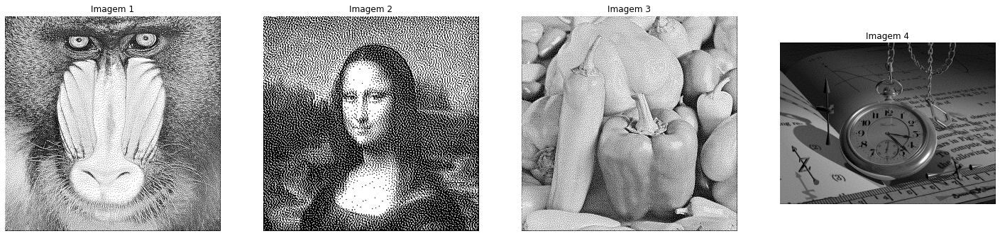

In [ ]:
img1_f6_n=jarvis_judice_ninke(img1_v, 0)
img2_f6_n=jarvis_judice_ninke(img2_v, 0)
img3_f6_n=jarvis_judice_ninke(img3_v, 0)
img4_f6_n=jarvis_judice_ninke(img4_v, 0)
sub_plot_monocromatic(img1_f6_n,img2_f6_n,img3_f5_n,img4_f6_n)

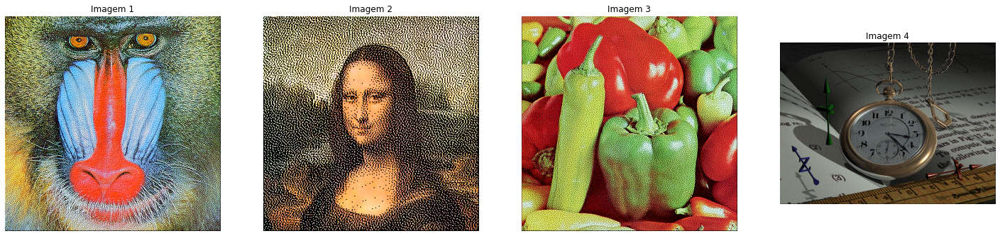

In [ ]:
img1_rgb_f6_n = hsv_to_rgb(img1_f6_n,img1_hsv)
img2_rgb_f6_n = hsv_to_rgb(img2_f6_n,img2_hsv)
img3_rgb_f6_n = hsv_to_rgb(img3_f6_n,img3_hsv)
img4_rgb_f6_n = hsv_to_rgb(img4_f6_n,img4_hsv)
sub_plot(img1_rgb_f6_n,img2_rgb_f6_n,img3_rgb_f6_n,img4_rgb_f6_n)

In [ ]:
# imageio.imwrite("results/f6/n/img1_rgb_f6_n.png", img1_rgb_f6_n)
# imageio.imwrite("results/f6/n/img2_rgb_f6_n.png", img2_rgb_f6_n)
# imageio.imwrite("results/f6/n/img3_rgb_f6_n.png", img3_rgb_f6_n)
# imageio.imwrite("results/f6/n/img4_rgb_f6_n.png", img4_rgb_f6_n)

### Zigzag Scan

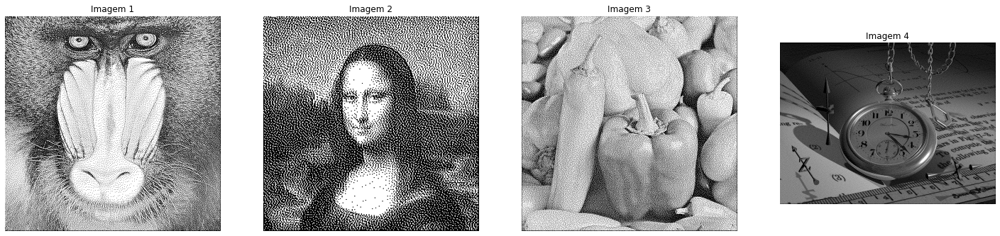

In [ ]:
img1_f6_z=jarvis_judice_ninke(img1_v, 0)
img2_f6_z=jarvis_judice_ninke(img2_v, 0)
img3_f6_z=jarvis_judice_ninke(img3_v, 0)
img4_f6_z=jarvis_judice_ninke(img4_v, 0)
sub_plot_monocromatic(img1_f6_z,img2_f6_z,img3_f5_z,img4_f6_z)

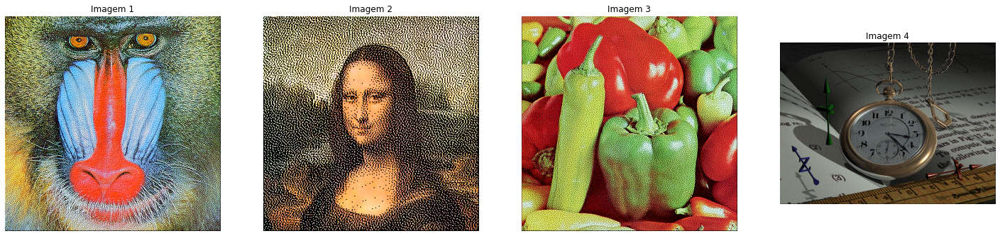

In [ ]:
img1_rgb_f6_z = hsv_to_rgb(img1_f6_z,img1_hsv)
img2_rgb_f6_z = hsv_to_rgb(img2_f6_z,img2_hsv)
img3_rgb_f6_z = hsv_to_rgb(img3_f6_z,img3_hsv)
img4_rgb_f6_z = hsv_to_rgb(img4_f6_z,img4_hsv)
sub_plot(img1_rgb_f6_z,img2_rgb_f6_z,img3_rgb_f6_z,img4_rgb_f6_z)

In [ ]:
# imageio.imwrite("results/f6/z/img1_rgb_f6_z.png", img1_rgb_f6_z)
# imageio.imwrite("results/f6/z/img2_rgb_f6_z.png", img2_rgb_f6_z)
# imageio.imwrite("results/f6/z/img3_rgb_f6_z.png", img3_rgb_f6_z)
# imageio.imwrite("results/f6/z/img4_rgb_f6_z.png", img4_rgb_f6_z)

### Discussões

Na imagem 1 observa-se  um resultado satisfatório, pois o dithering é visualmente agradável.

Observa-se que na imagem 2 há grandes perdas de detalhes da imagem. 

Na imagem 3, tem-se um claro padrão de direção em ambas as varreduras, porém na orientação zigzag esse padrão é suavizado,

Na imagem 4, observa-se algumas alterações nos detalhes horizontais e em regiões homogêneas.

## Comparando Filtros e Scans

Nessa sessão os filtros seram comparados para as quatro imagens nas duas orientações de varreduras, normal e zigzag.

### Imagem 1

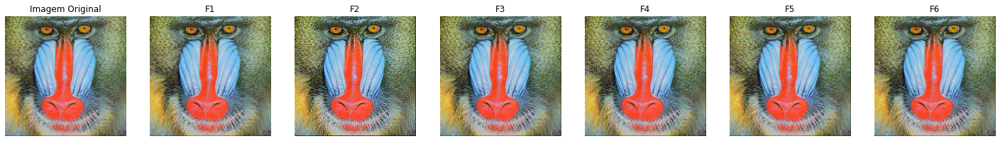

In [ ]:
#Imagem 1 normal scan
sub_plot_7(img1,img1_rgb_f1_n,img1_rgb_f2_n,img1_rgb_f3_n,img1_rgb_f4_n,img1_rgb_f5_n,img1_rgb_f6_n)

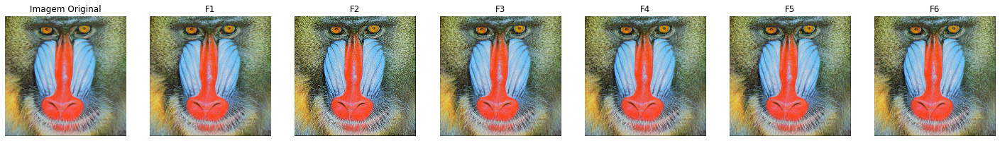

In [ ]:
#Imagem 1 zigzag scan
sub_plot_7(img1,img1_rgb_f1_z,img1_rgb_f2_z,img1_rgb_f3_z,img1_rgb_f4_z,img1_rgb_f5_z,img1_rgb_f6_z)

### Imagem 2

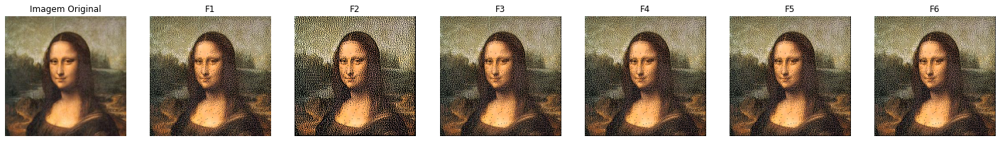

In [ ]:
#Imagem 2 normal scan
sub_plot_7(img2,img2_rgb_f1_n,img2_rgb_f2_n,img2_rgb_f3_n,img2_rgb_f4_n,img2_rgb_f5_n,img2_rgb_f6_n)

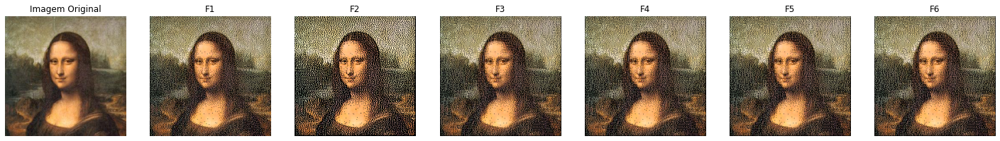

In [ ]:
#Imagem 2 zigzag scan
sub_plot_7(img2,img2_rgb_f1_z,img2_rgb_f2_z,img2_rgb_f3_z,img2_rgb_f4_z,img2_rgb_f5_z,img2_rgb_f6_z)

### Imagem 3

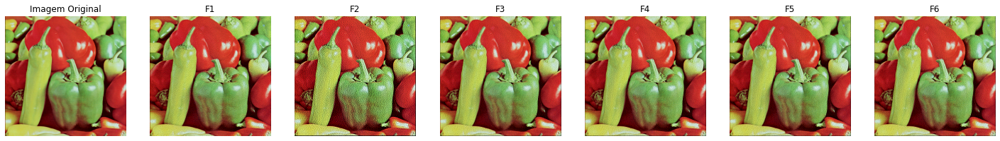

In [ ]:
#Imagem 3 normal scan
sub_plot_7(img3,img3_rgb_f1_n,img3_rgb_f2_n,img3_rgb_f3_n,img3_rgb_f4_n,img3_rgb_f5_n,img3_rgb_f6_n)

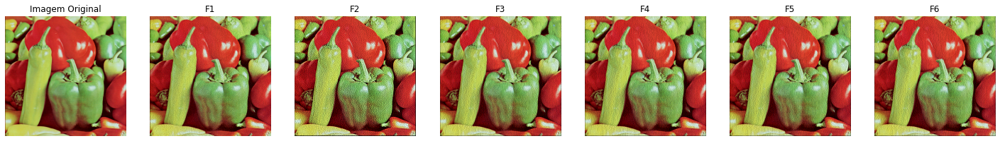

In [ ]:
#Imagem 3 zigzag scan
sub_plot_7(img3,img3_rgb_f1_z,img3_rgb_f2_z,img3_rgb_f3_z,img3_rgb_f4_z,img3_rgb_f5_z,img3_rgb_f6_z)

### Imagem 4

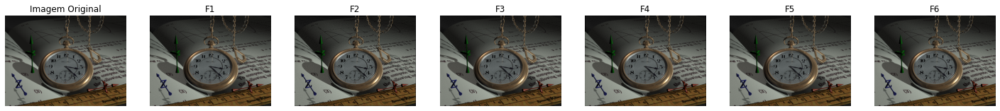

In [ ]:
#Imagem 4 normal scan
sub_plot_7(img4,img4_rgb_f1_n,img4_rgb_f2_n,img4_rgb_f3_n,img4_rgb_f4_n,img4_rgb_f5_n,img4_rgb_f6_n)

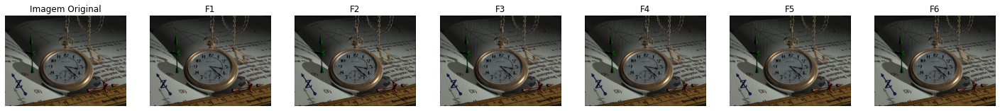

In [ ]:
#Imagem 4 zigzag scan
sub_plot_7(img4,img4_rgb_f1_z,img4_rgb_f2_z,img4_rgb_f3_z,img4_rgb_f4_z,img4_rgb_f5_z,img4_rgb_f6_z)

### Discussão

É possivel observar ao comparar os filtros, que para todas as imagens, o filtro 2 teve o pior resultado visualmente em ambas direções. Na imagem 1, a saída do filtro distorce muitos detalhes da textura da imagem original. Na imagem 2, a pintura teve grandes distorções e ficou muito visivel um padrão nos pixels. A imagem 3 aparenta estar bem ruidosa e por fim, a imagem 4 é possivel observar uma grande perda de detalhes e alterações nas regiões homogêneas.

Visualmente, o filtro um teve o melhor resultado para as quatro imagens, pois o dithering ocorreu de forma suave e agradável aos olhos. 

Quanto a orientação da varredura, é possível observar que no scan normal as imagens de saída dos filtros apresentam um certo padrão, que não fica tão explicito no scan em zigzag.


## Memory Use

A operação de dithering é utilizada como uma forma de compressão, logo é apresentado a analise de memoria antes e depois de cada filtro em cada scan em porcentagem, onde a base são as imagens originais (por exemplo, a imagem 1 é 100% dela e a saída do filtro 1 com scan normal possui 80% do tamanho da imagem original).

In [ ]:
orig = np.array([os.stat('baboon.png').st_size, os.stat('monalisa.png').st_size,os.stat('peppers.png').st_size,os.stat('watch.png').st_size])

d = {'Imagem Original':  np.array([os.stat('baboon.png').st_size, os.stat('monalisa.png').st_size,os.stat('peppers.png').st_size,os.stat('watch.png').st_size]) * 100 / orig, 
     'Imagem_F1_normal': np.array([os.stat('img1_rgb_f1_n.png').st_size, os.stat('img2_rgb_f1_n.png').st_size,os.stat('img3_rgb_f1_n.png').st_size,os.stat('img4_rgb_f1_n.png').st_size]) * 100 / orig,
     'Imagem_F1_zigzag': np.array([os.stat('img1_rgb_f1_z.png').st_size, os.stat('img2_rgb_f1_z.png').st_size,os.stat('img3_rgb_f1_z.png').st_size,os.stat('img4_rgb_f1_z.png').st_size]) * 100 / orig,
     'Imagem_F2_normal': np.array([os.stat('img1_rgb_f2_n.png').st_size, os.stat('img2_rgb_f2_n.png').st_size,os.stat('img3_rgb_f2_n.png').st_size,os.stat('img4_rgb_f2_n.png').st_size]) * 100 / orig,
     'Imagem_F2_zigzag': np.array([os.stat('img1_rgb_f2_z.png').st_size, os.stat('img2_rgb_f2_z.png').st_size,os.stat('img3_rgb_f2_z.png').st_size,os.stat('img4_rgb_f2_z.png').st_size]) * 100 / orig,
     'Imagem_F3_normal': np.array([os.stat('img1_rgb_f3_n.png').st_size, os.stat('img2_rgb_f3_n.png').st_size,os.stat('img3_rgb_f3_n.png').st_size,os.stat('img4_rgb_f3_n.png').st_size]) * 100 / orig,
     'Imagem_F3_zigzag': np.array([os.stat('img1_rgb_f3_z.png').st_size, os.stat('img2_rgb_f3_z.png').st_size,os.stat('img3_rgb_f3_z.png').st_size,os.stat('img4_rgb_f3_z.png').st_size]) * 100 / orig,
     'Imagem_F4_normal': np.array([os.stat('img1_rgb_f4_n.png').st_size, os.stat('img2_rgb_f4_n.png').st_size,os.stat('img3_rgb_f4_n.png').st_size,os.stat('img4_rgb_f4_n.png').st_size]) * 100 / orig,
     'Imagem_F4_zigzag': np.array([os.stat('img1_rgb_f4_z.png').st_size, os.stat('img2_rgb_f4_z.png').st_size,os.stat('img3_rgb_f4_z.png').st_size,os.stat('img4_rgb_f4_z.png').st_size]) * 100 / orig,
     'Imagem_F5_normal': np.array([os.stat('img1_rgb_f5_n.png').st_size, os.stat('img2_rgb_f5_n.png').st_size,os.stat('img3_rgb_f5_n.png').st_size,os.stat('img4_rgb_f5_n.png').st_size]) * 100 / orig,
     'Imagem_F5_zigzag': np.array([os.stat('img1_rgb_f5_z.png').st_size, os.stat('img2_rgb_f5_z.png').st_size,os.stat('img3_rgb_f5_z.png').st_size,os.stat('img4_rgb_f5_z.png').st_size]) * 100 / orig,
     'Imagem_F6_normal': np.array([os.stat('img1_rgb_f6_n.png').st_size, os.stat('img2_rgb_f6_n.png').st_size,os.stat('img3_rgb_f6_n.png').st_size,os.stat('img4_rgb_f6_n.png').st_size]) * 100 / orig,
     'Imagem_F6_zigzag': np.array([os.stat('img1_rgb_f6_z.png').st_size, os.stat('img2_rgb_f6_z.png').st_size,os.stat('img3_rgb_f6_z.png').st_size,os.stat('img4_rgb_f6_z.png').st_size]) * 100 / orig}


df = pd.DataFrame(data=d)
df

,Imagem Original,Imagem_F1_normal,Imagem_F1_zigzag,Imagem_F2_normal,Imagem_F2_zigzag,Imagem_F3_normal,Imagem_F3_zigzag,Imagem_F4_normal,Imagem_F4_zigzag,Imagem_F5_normal,Imagem_F5_zigzag,Imagem_F6_normal,Imagem_F6_zigzag
0,100.0,81.874537,82.314593,77.870563,77.751918,80.428191,80.474174,79.754140,79.730285,80.334028,79.963810,79.377487,79.377487
1,100.0,81.959428,81.935956,82.918198,83.668421,79.572436,79.274513,85.032546,85.381025,79.839663,79.166178,85.288940,85.288940
2,100.0,100.499119,99.854849,96.007788,96.226814,98.209927,98.392201,100.440650,100.604920,98.355264,98.496146,100.531231,100.531231
3,100.0,53.443339,53.362714,55.413195,56.206962,55.409178,55.568850,56.350996,55.915594,54.404524,54.477259,55.742724,55.742724


### Discussões

É possível observar que houve maior redução de cada imagem no filtro:

*   Imagem 1 - Filtro 2 no scan zigzag
*   Imagem 2 - Filtro 5 no scan zigzag
*   Imagem 3 - Filtro 2 no scan normal
*   Imagem 4 - Filtro 1 no scan zigzag

Além disso, na imagem 3 em especial, teve casos onde a imagem com dithering foi maior do que a original ou pouca redução, acredita-se que isso aconteça por ter sido induzido ruídos a imagem ou pelo canal de luminancia não possuir informações tão relevantes para a imagem.

Também observa-se que a imagem 4 possuiu uma redução de quase 50% do tamanho para todos os filtros.

Logo, conclui-se que há redução, porém varia de caso a caso.

# Conclusões

Conclui-se que o filtro que mostrou melhor resultado visual foi o filtro 1 (Floyd e Streinberg) e o que mostrou pior resultado visual foi o filtro 2 (Stevenson e Arce).
Ambas as orientações de varedura mostram resultados bom, porém no scan normal é possível observar padrões de direção, o que no scan em zigzag fica bem mais suavizado. Logo a varredura em zigzag possui um melhor resultado.
Quanto ao uso de memória, o filtro 2, numa observação geral, foi o filtro que mais reduziu. Porém, também foi observado que numa analise imagem a imagem, houveram filtros que obtiveram melhor resultado. Logo, é necessário fazer uma análise caso a caso.

# Teste com outras imagens

Entre com uma imagem sua em png de 3 canais RGB e refaça o experimento.

### Input

Nome da imagem com a extensão:rick.png


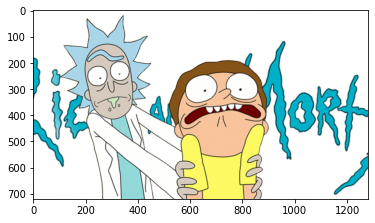

In [ ]:
filename = input('Nome da imagem com a extensão:')
img = imageio.imread(filename)
plt.imshow(img)

In [ ]:
img.shape

(720, 1280, 4)

### Pre-processamento

In [ ]:
#preprocessamento
img_hsv,img_v = rgb_to_hsv(img[:,:,0:3])

### Filtro 1

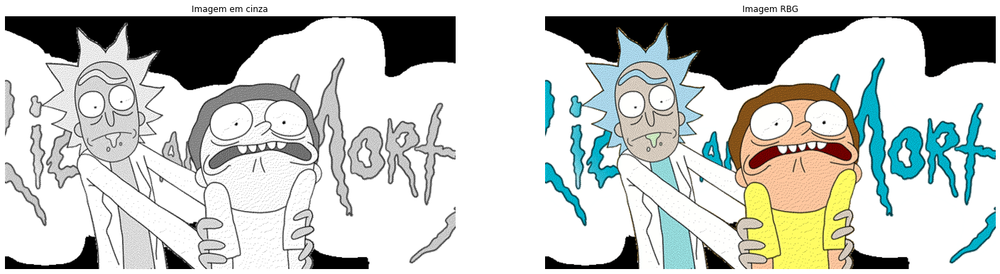

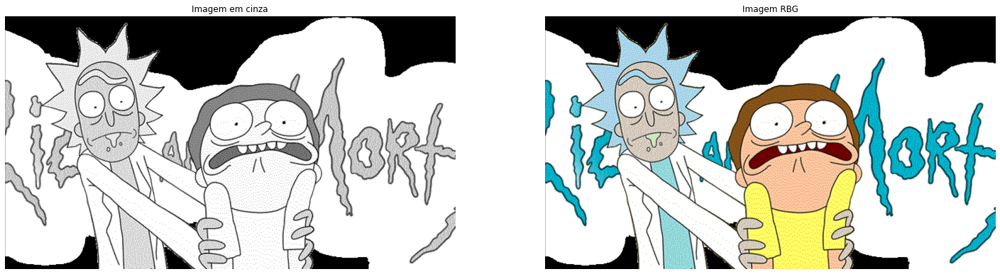

In [ ]:
#normal scan

img_f1_n=floyd_steinberg(img_v, 0)
img_rgb_f1_n = hsv_to_rgb(img_f1_n,img_hsv)

sub_plot_2(img_f1_n,img_rgb_f1_n) 

#Zigzag Scan

img_f1_z=floyd_steinberg(img_v, 1)
img_rgb_f1_z = hsv_to_rgb(img_f1_z,img_hsv)

sub_plot_2(img_f1_z,img_rgb_f1_z) 

### Filtro 2

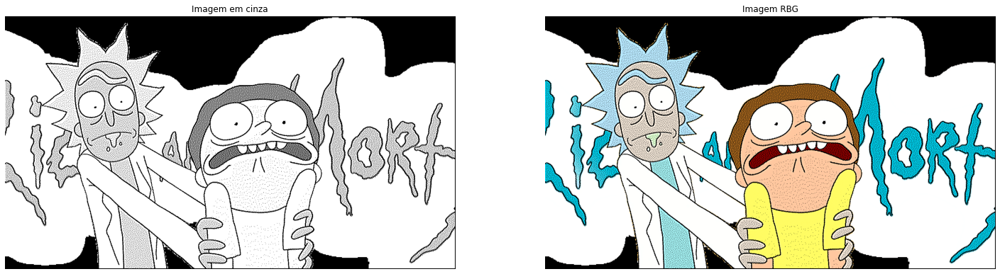

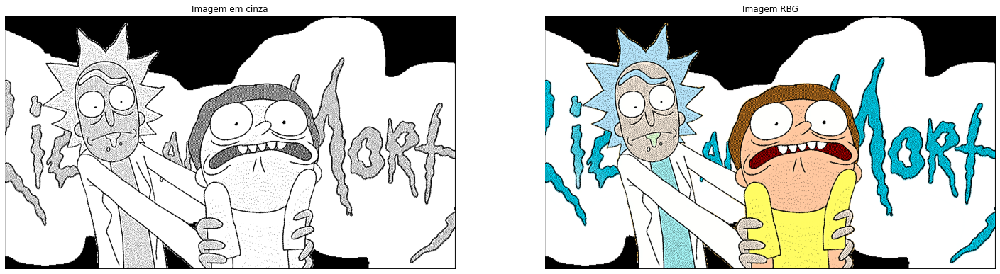

In [ ]:
#normal scan

img_f2_n=stevenson_arce(img_v, 0)
img_rgb_f2_n = hsv_to_rgb(img_f2_n,img_hsv)

sub_plot_2(img_f2_n,img_rgb_f2_n) 

#Zigzag Scan

img_f2_z=stevenson_arce(img_v, 1)
img_rgb_f2_z = hsv_to_rgb(img_f2_z,img_hsv)

sub_plot_2(img_f2_z,img_rgb_f2_z) 

### Filtro 3

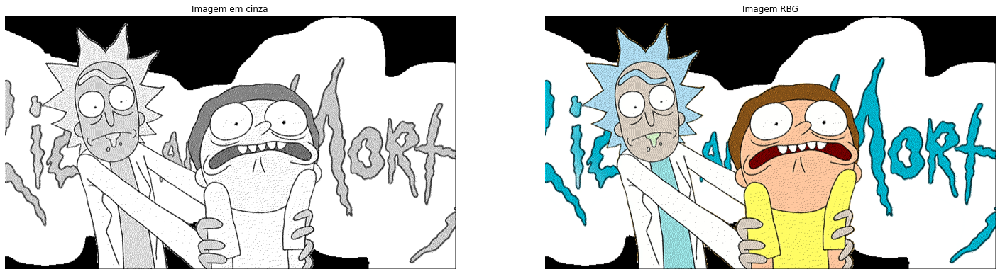

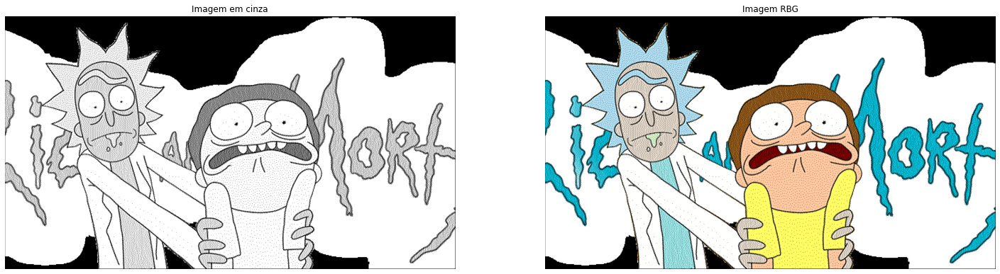

In [ ]:
#normal scan

img_f3_n=burkes(img_v, 0)
img_rgb_f3_n = hsv_to_rgb(img_f3_n,img_hsv)

sub_plot_2(img_f3_n,img_rgb_f3_n) 

#Zigzag Scan

img_f3_z=burkes(img_v, 1)
img_rgb_f3_z = hsv_to_rgb(img_f3_z,img_hsv)

sub_plot_2(img_f3_z,img_rgb_f3_z) 

### Filtro 4

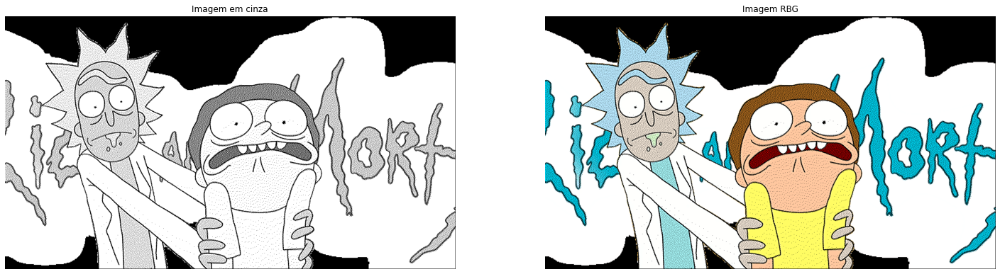

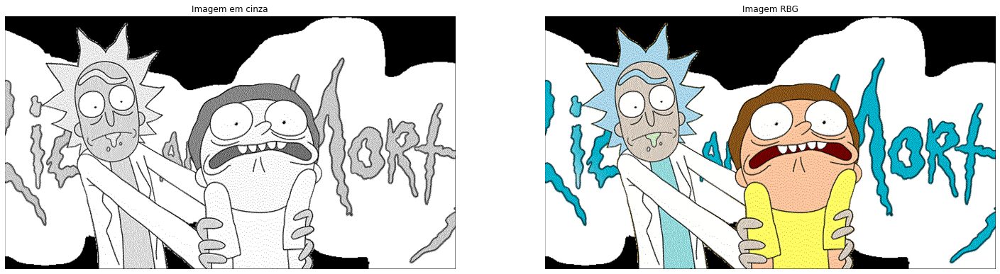

In [ ]:
#normal scan

img_f4_n=sierra(img_v, 0)
img_rgb_f4_n = hsv_to_rgb(img_f4_n,img_hsv)

sub_plot_2(img_f4_n,img_rgb_f4_n) 

#Zigzag Scan

img_f4_z=sierra(img_v, 1)
img_rgb_f4_z = hsv_to_rgb(img_f4_z,img_hsv)

sub_plot_2(img_f4_z,img_rgb_f4_z) 


### Filtro 5

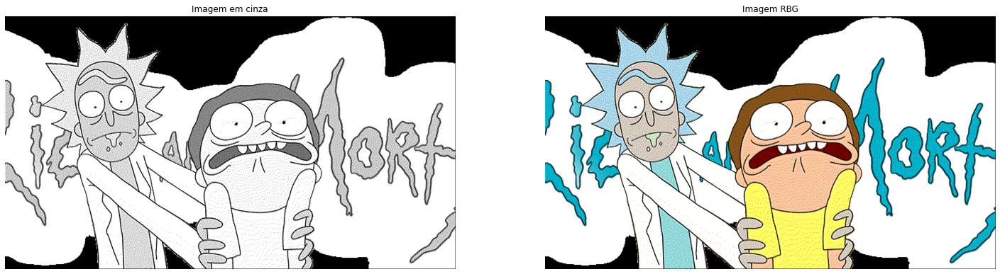

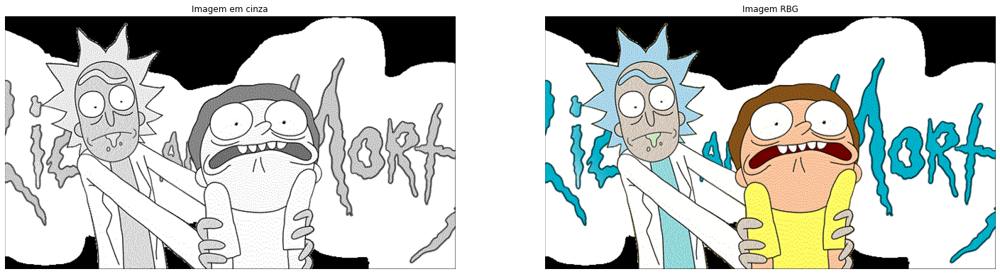

In [ ]:
#normal scan

img_f5_n=stucki(img_v, 0)
img_rgb_f5_n = hsv_to_rgb(img_f5_n,img_hsv)

sub_plot_2(img_f5_n,img_rgb_f5_n) 

#Zigzag Scan

img_f5_z=stucki(img_v, 1)
img_rgb_f5_z = hsv_to_rgb(img_f5_z,img_hsv)

sub_plot_2(img_f5_z,img_rgb_f5_z) 

### Filtro 6

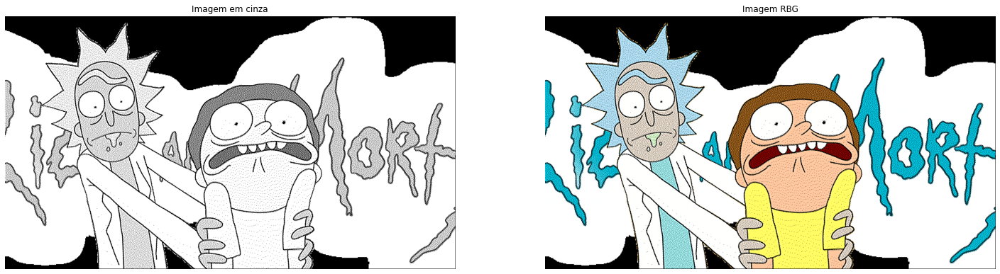

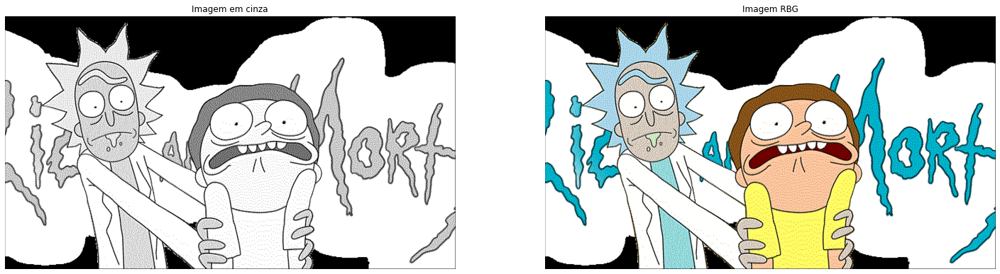

In [ ]:
#normal scan

img_f6_n=jarvis_judice_ninke(img_v, 0)
img_rgb_f6_n = hsv_to_rgb(img_f6_n,img_hsv)

sub_plot_2(img_f6_n,img_rgb_f6_n) 

#Zigzag Scan

img_f6_z=jarvis_judice_ninke(img_v, 1)
img_rgb_f6_z = hsv_to_rgb(img_f6_z,img_hsv)

sub_plot_2(img_f6_z,img_rgb_f6_z) 

In [ ]:
imageio.imwrite("img_rgb_f1_n.png", img_rgb_f1_n)
imageio.imwrite("img_rgb_f2_n.png", img_rgb_f2_n)
imageio.imwrite("img_rgb_f3_n.png", img_rgb_f3_n)
imageio.imwrite("img_rgb_f4_n.png", img_rgb_f4_n)
imageio.imwrite("img_rgb_f5_n.png", img_rgb_f5_n)
imageio.imwrite("img_rgb_f6_n.png", img_rgb_f6_n)

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


In [ ]:
imageio.imwrite("img_rgb_f1_z.png", img_rgb_f1_z)
imageio.imwrite("img_rgb_f2_z.png", img_rgb_f2_z)
imageio.imwrite("img_rgb_f3_z.png", img_rgb_f3_z)
imageio.imwrite("img_rgb_f4_z.png", img_rgb_f4_z)
imageio.imwrite("img_rgb_f5_z.png", img_rgb_f5_z)
imageio.imwrite("img_rgb_f6_z.png", img_rgb_f6_z)

Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float32 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
